<a href="https://colab.research.google.com/github/Risto8456/Machine-Learning---Face-Recognition/blob/main/Face_Recognition.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 機器學習報告 - 臉部辨識

## 第一步：臉部偵測（Face Detection）

### 1) 掛載 Google Drive、安裝套件
+ facenet-pytorch 的 MTCNN 是常用與穩定的輕量偵測器。
+ mediapipe 非常快且穩定。
+ 可兩者比較。

In [6]:
# Colab Cell 1 - 掛載 Drive 與安裝套件
from google.colab import drive
drive.mount('/content/drive')

# 安裝套件（只需執行一次）
!pip install facenet-pytorch==2.5.2       # MTCNN (人臉偵測)
!pip install mediapipe opencv-python-headless matplotlib tqdm
!pip install Pillow


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


### 2) 設定路徑與載入圖片列表

In [7]:
# Colab Cell 2 - 設定
import os, glob
from pathlib import Path

# 在 Drive 上放置圖片的資料夾
DRIVE_IMG_FOLDER = "/content/drive/MyDrive/Colab Notebooks/machine_learning/final/face_images"  # 圖片資料夾路徑
OUT_FOLDER = "/content/face_detection_output"       # 輸出資料夾路徑
os.makedirs(OUT_FOLDER, exist_ok=True)
os.makedirs(os.path.join(OUT_FOLDER, "crops"), exist_ok=True)
os.makedirs(os.path.join(OUT_FOLDER, "vis"), exist_ok=True)

# 取得圖片清單（支援 jpg/png）
img_paths = sorted(glob.glob(os.path.join(DRIVE_IMG_FOLDER, "*.[jJpP][pPnN][gG]")))
print(f"Found {len(img_paths)} images, example:\n", img_paths[:5])


Found 5 images, example:
 ['/content/drive/MyDrive/Colab Notebooks/machine_learning/final/face_images/1.jpg', '/content/drive/MyDrive/Colab Notebooks/machine_learning/final/face_images/2.jpg', '/content/drive/MyDrive/Colab Notebooks/machine_learning/final/face_images/3.jpg', '/content/drive/MyDrive/Colab Notebooks/machine_learning/final/face_images/4.jpg', '/content/drive/MyDrive/Colab Notebooks/machine_learning/final/face_images/5.jpg']


### 3) MTCNN (facenet-pytorch) 偵測 + 儲存結果與可視化
+ 執行完後，會在 /content/face_detection_output/ 下看到：
  1. crops/：每個偵測到的人臉 crop 圖檔
  2. vis/：原圖加上 bounding box 與 landmarks 的可視化圖
  3. mtcnn_results.json：每張原圖的偵測清單（bbox、score、landmarks、crop_path）

In [8]:
# Colab Cell 3 - MTCNN偵測
import numpy as np
import cv2
import json
from facenet_pytorch import MTCNN
from PIL import Image
from tqdm import tqdm
import matplotlib.pyplot as plt

mtcnn = MTCNN(keep_all=True, device='cpu')  # 若有 GPU，可改 device='cuda'

results = {}  # 用來存所有圖片的偵測結果

for img_path in tqdm(img_paths, desc="MTCNN detect"):
    img_name = Path(img_path).name
    img = Image.open(img_path).convert("RGB")
    boxes, probs, landmarks = mtcnn.detect(img, landmarks=True)

    # boxes: N x 4; landmarks: N x 5 x 2 (if keep_all)
    vis = cv2.cvtColor(np.array(img), cv2.COLOR_RGB2BGR)
    items = []
    if boxes is not None:
        for i, box in enumerate(boxes):
            x1,y1,x2,y2 = [int(round(x)) for x in box]
            score = float(probs[i]) if probs is not None else None
            kps = landmarks[i].tolist() if landmarks is not None else []
            # crop and save
            crop = vis[max(0,y1):y2, max(0,x1):x2]
            crop_path = os.path.join(OUT_FOLDER, "crops", f"{Path(img_name).stem}_mtcnn_{i}.jpg")
            if crop.size != 0:
                cv2.imwrite(crop_path, crop)
            # 用方框標註
            cv2.rectangle(vis, (x1,y1), (x2,y2), (0,255,0), 5) # 線條粗細為 5
            if kps:
                for (lx,ly) in kps:
                    cv2.circle(vis, (int(lx), int(ly)), 5, (0,0,255), -1) # 線條粗細為 5
            items.append({
                "box": [x1,y1,x2,y2],
                "score": score,
                "landmarks": kps,
                "crop_path": crop_path
            })
    # save visualization
    vis_path = os.path.join(OUT_FOLDER, "vis", f"{Path(img_name).stem}_mtcnn_vis.jpg")
    cv2.imwrite(vis_path, vis)
    results[img_name] = items

# write JSON
with open(os.path.join(OUT_FOLDER, "mtcnn_results.json"), "w", encoding="utf-8") as f:
    json.dump(results, f, ensure_ascii=False, indent=2)

print("MTCNN results saved to:", os.path.join(OUT_FOLDER, "mtcnn_results.json"))

MTCNN detect: 100%|██████████| 5/5 [01:14<00:00, 14.88s/it]

MTCNN results saved to: /content/face_detection_output/mtcnn_results.json


### 4) MediaPipe 偵測版本（更快的替代方案）

In [9]:
# Colab Cell 4 - MediaPipe Face Detection (single face or multiple)
import mediapipe as mp
mp_face_detection = mp.solutions.face_detection
mp_drawing = mp.solutions.drawing_utils

results_mp = {}
import math

with mp_face_detection.FaceDetection(model_selection=1, min_detection_confidence=0.5) as face_detector:
    for img_path in tqdm(img_paths, desc="MediaPipe detect"):
        img_name = Path(img_path).name
        orig = cv2.imread(img_path)
        img_rgb = cv2.cvtColor(orig, cv2.COLOR_BGR2RGB)
        r = face_detector.process(img_rgb)
        vis = orig.copy()
        items = []
        if r.detections:
            h, w = orig.shape[:2]
            for i, det in enumerate(r.detections):
                # bounding box
                bboxC = det.location_data.relative_bounding_box
                x1 = int(bboxC.xmin * w)
                y1 = int(bboxC.ymin * h)
                bw = int(bboxC.width * w)
                bh = int(bboxC.height * h)
                x2 = x1 + bw
                y2 = y1 + bh
                score = float(det.score[0]) if det.score else None

                # landmarks if available (MediaPipe detection has limited landmarks)
                kps = []
                if det.location_data.relative_keypoints:
                    for kp in det.location_data.relative_keypoints:
                        kps.append([int(kp.x * w), int(kp.y * h)])

                # save crop
                crop = vis[max(0,y1):y2, max(0,x1):x2]
                crop_path = os.path.join(OUT_FOLDER, "crops", f"{Path(img_name).stem}_mp_{i}.jpg")
                if crop.size != 0:
                    cv2.imwrite(crop_path, crop)

                # 用方框標註
                cv2.rectangle(vis, (x1,y1), (x2,y2), (255,0,0), 5)
                for (lx,ly) in kps:
                    cv2.circle(vis, (lx,ly), 5, (0,255,255), -1)

                items.append({
                    "box": [x1,y1,x2,y2],
                    "score": score,
                    "landmarks": kps,
                    "crop_path": crop_path
                })
        vis_path = os.path.join(OUT_FOLDER, "vis", f"{Path(img_name).stem}_mp_vis.jpg")
        cv2.imwrite(vis_path, vis)
        results_mp[img_name] = items

with open(os.path.join(OUT_FOLDER, "mp_results.json"), "w", encoding="utf-8") as f:
    json.dump(results_mp, f, ensure_ascii=False, indent=2)

print("MediaPipe results saved to:", os.path.join(OUT_FOLDER, "mp_results.json"))


MediaPipe detect: 100%|██████████| 5/5 [00:04<00:00,  1.10it/s]

MediaPipe results saved to: /content/face_detection_output/mp_results.json


### 5) 在 Colab 顯示幾張可視化結果（inline）

Example visualization files: ['/content/face_detection_output/vis/1_mp_vis.jpg', '/content/face_detection_output/vis/1_mtcnn_vis.jpg', '/content/face_detection_output/vis/2_mp_vis.jpg', '/content/face_detection_output/vis/2_mtcnn_vis.jpg', '/content/face_detection_output/vis/3_mp_vis.jpg', '/content/face_detection_output/vis/3_mtcnn_vis.jpg']
Displaying: 1_mp_vis.jpg


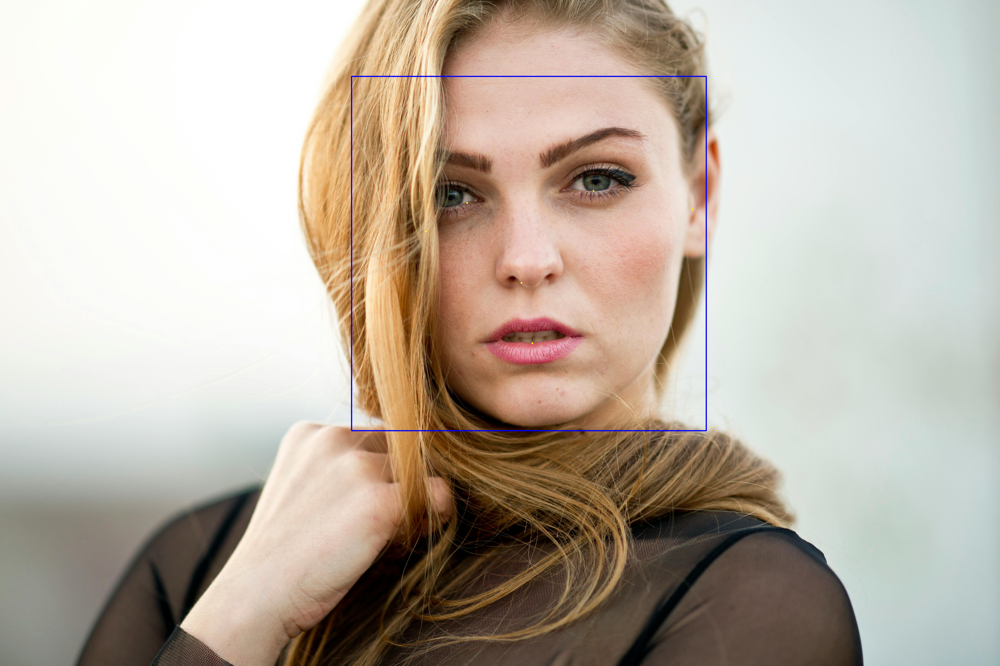

Displaying: 1_mtcnn_vis.jpg


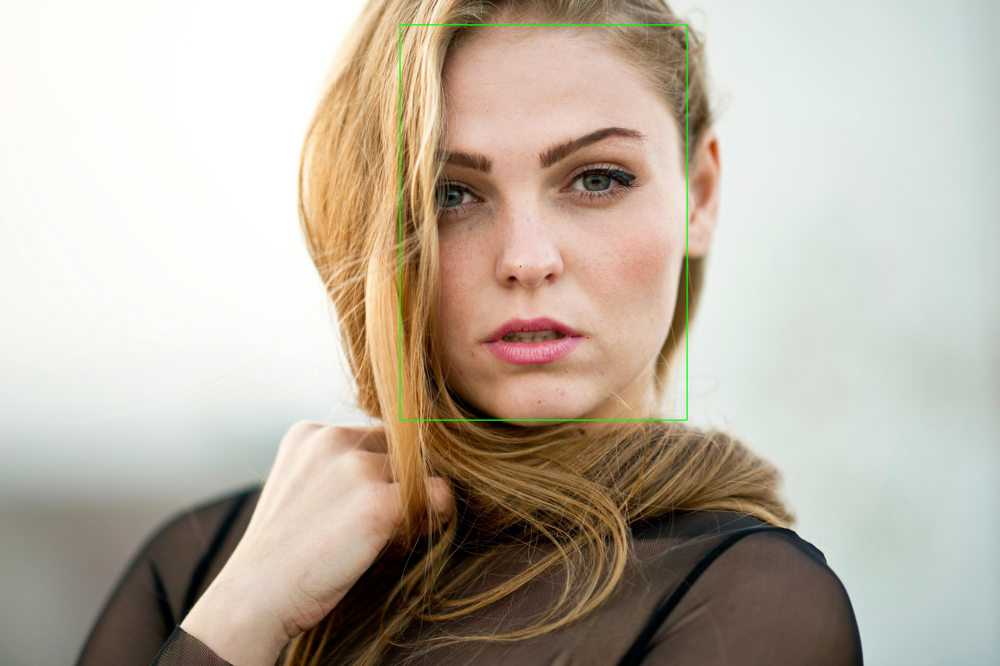

Displaying: 2_mp_vis.jpg


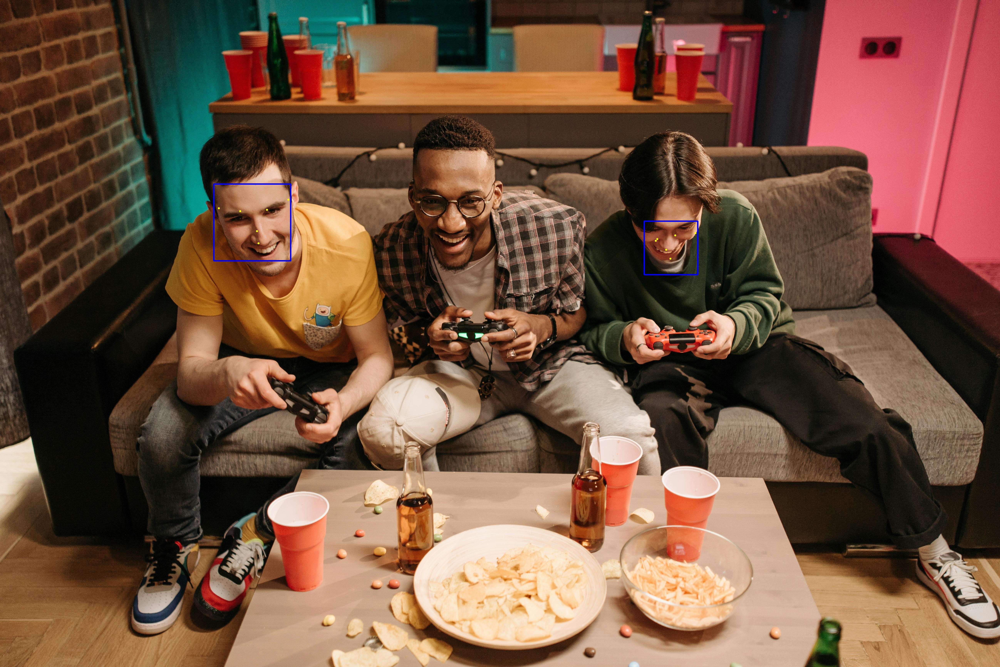

Displaying: 2_mtcnn_vis.jpg


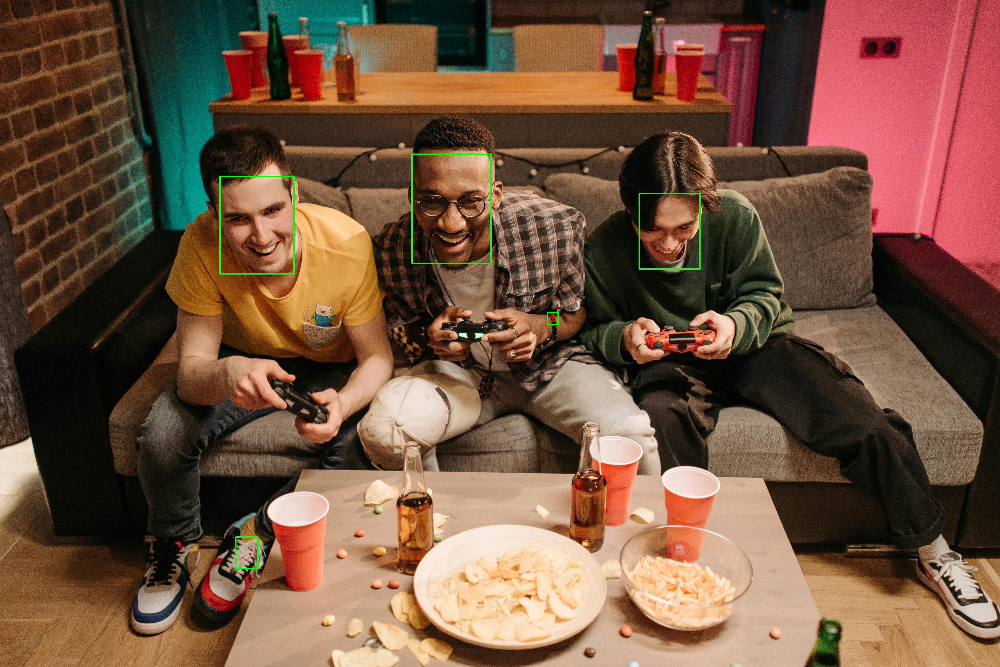

Displaying: 3_mp_vis.jpg


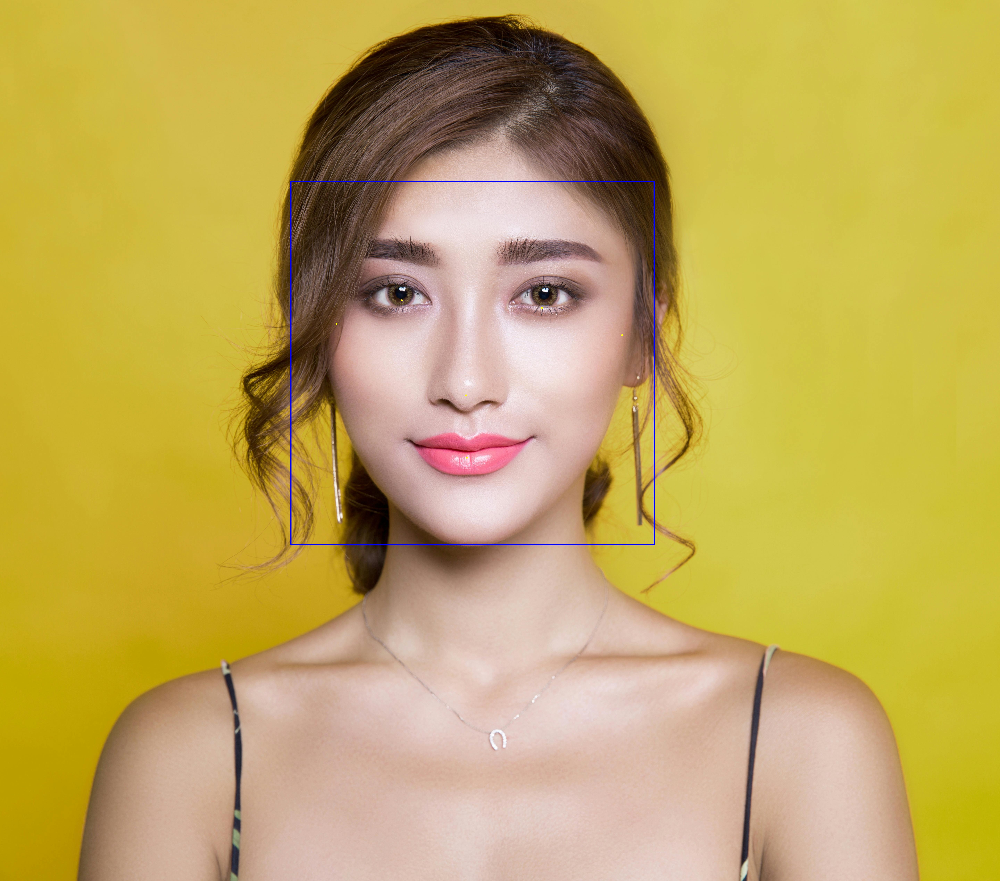

Displaying: 3_mtcnn_vis.jpg


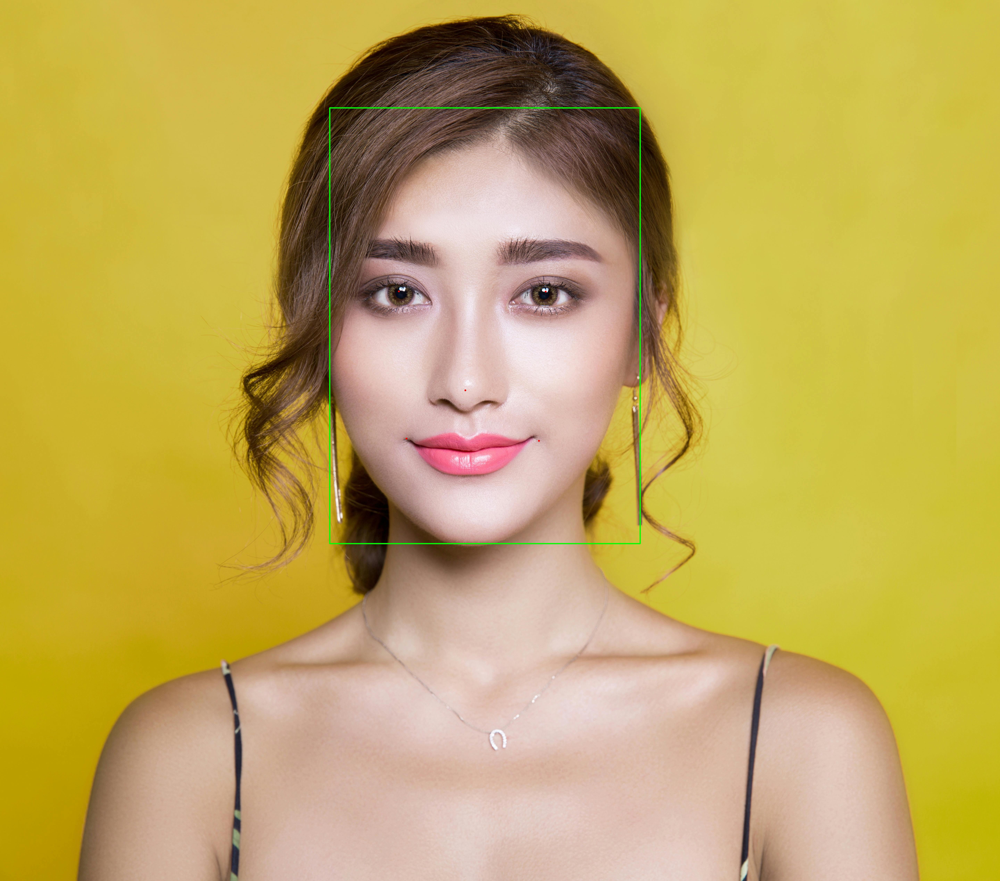

In [12]:
# Colab Cell 5 - 顯示一些可視化結果
from IPython.display import Image, display
import os
vis_files = sorted(glob.glob(os.path.join(OUT_FOLDER, "vis", "*_vis.jpg")))
print("Example visualization files:", vis_files[:6])
for vf in vis_files[:6]:
    print(f"Displaying: {os.path.basename(vf)}")
    display(Image(vf, width=600))

###